# Chaos and Fractals: An Elementary Introduction

The following notebook contains investigations in F# based upon the book [*Chaos and Fractals: An Elementary Introduction* by David P. Feldman](http://hornacek.coa.edu/dave/Chaos/).

### Dependencies

In [1]:
#r "nuget: Plotly.NET.Interactive"
#r "nuget: Plotly.NET.ImageExport"

Installed Packages Plotly.NET.ImageExport, 5.0.1 Plotly.NET.Interactive, 4.2.1

Loading extensions from `C:\Users\bmitc\.nuget\packages\plotly.net.interactive\4.2.1\interactive-extensions\dotnet\Plotly.NET.Interactive.dll`

In [2]:
#load @"..\fsharp-math\Math\Math\Math\Complex.fs"

In [3]:
open FSharp.Math.Complex

In [4]:
open System.Runtime.CompilerServices

open Plotly.NET
open Plotly.NET.ImageExport
open Plotly.NET.LayoutObjects
open Plotly.NET.TraceObjects

### Utilities

In [5]:
type Coordinate =
    { X: float
      Y: float
      Z: float } with
    
    member this.AsTuple = (this.X, this.Y, this.Z)
    static member ToTuple {Coordinate.X = x; Y = y; Z = z} = (x, y, z)

let coordinate (x, y, z) = {X = x; Y = y; Z = z}

type Plot =
    { Time: float 
      Coordinate: Coordinate }

In [6]:
let axis3D = LinearAxis.init(
    ShowLine = false,
    ShowGrid = false,
    ShowBackground = false,
    Color = Color.fromKeyword(White),
    Ticks = StyleParam.TickOptions.Empty,
    Visible = false
)

let scene3D = Scene.init(
    BGColor = Color.fromKeyword(White),
    XAxis = axis3D,
    YAxis = axis3D,
    ZAxis = axis3D
)

let layout3D = Layout.init(
    PlotBGColor = Color.fromKeyword(White),
    PaperBGColor = Color.fromKeyword(White)
)

let margin3D = Margin.init(
    Left = 0,
    Right = 0,
    Top = 0,
    Bottom = 0,
    Pad = 0,
    Autoexpand = true
)

let plot plot =
    plot
    |> List.map (fun plot -> plot.Coordinate.AsTuple)
    |> (fun x -> Chart.Line3D(x,
        LineColor = Color.fromARGB 65 0 0 0))
    |> Chart.withLayout layout3D
    |> Chart.withScene scene3D
    |> Chart.withMargin margin3D
    |> Chart.withXAxis axis3D
    |> Chart.withYAxis axis3D
    |> Chart.withZAxis axis3D

In [7]:
let staticConfig = Config.init(
    StaticPlot = true
)

type Chart with
    static member Display (chart: GenericChart.GenericChart) =
        match GenericChart.tryGetLayoutSize chart with
        | Some width, Some height ->
            chart
            |> Chart.withConfig staticConfig
            |> Chart.toSVGString(Width = width, Height = height)
            |> (fun chart -> chart.DisplayAs "text/html")
        | _ ->
            chart
            |> Chart.withConfig staticConfig
            |> Chart.toSVGString()
            |> (fun chart -> chart.DisplayAs "text/html")

    static member Display3D (x, y, z, chart: GenericChart.GenericChart) =
        let axis3D = LinearAxis.init(
            ShowLine = false,
            ShowGrid = false,
            ShowBackground = false,
            Color = Color.fromKeyword(White),
            Ticks = StyleParam.TickOptions.Empty,
            Visible = false
        )

        match GenericChart.tryGetLayoutSize chart with
        | Some width, Some height ->
            chart
            |> Chart.withConfig staticConfig
            |> Chart.withSceneStyle(
                Camera = Camera.init(
                    Center = CameraCenter.init(0, 0, 0),
                    Eye = CameraEye.init(x, y, z),
                    Up = CameraUp.init(0, 0, 1)
                )
            )
            |> Chart.toSVGString(Width = width, Height = height)
            |> (fun chart -> chart.DisplayAs "text/html")
        | _ ->
            chart
            |> Chart.withConfig staticConfig
            |> Chart.withSceneStyle(
                Camera = Camera.init(Center = CameraCenter.init(x, y, z))
            )
            |> Chart.toSVGString()
            |> (fun chart -> chart.DisplayAs "text/html")

### Chapter 24: Julia Sets for the Quadratic Family

In [8]:
let f (c: Complex) (z: Complex) = (z * z) + c

let test = f (complex 1 0)

let functionIteration (f: Complex -> Complex) (z0: Complex): seq<Complex> =
    f z0
    |> Seq.unfold (fun state ->
        let newState = f state
        Some (state, newState))

let goesToInfinity f (c: Complex) (z0: Complex) =
    let R = max 2.0 (Complex.Abs c)

    let iterates =
        Seq.zip (functionIteration (f c) z0) (Seq.initInfinite id)
        |> Seq.takeWhile (fun (z, i) -> Complex.Abs z < R && i <= 100)
    Seq.length iterates < 100

In [9]:
let plotJuliaSet data =
    data
    |> Chart.Point
    |> Chart.withMarkerStyle(Size = 1)
    |> Chart.withConfig staticConfig
    |> Chart.toSVGString()
    |> (fun chart -> chart.DisplayAs "text/html")

In [10]:
goesToInfinity f (complex 1 0) (complex 0 0)

True

In [11]:
goesToInfinity f (complex 1 0) (complex 0 1)

True

In [12]:
goesToInfinity f (complex 1 0) (complex 1 1)

True

In [13]:
goesToInfinity f (complex 1 0) (complex 0.8 0.2)

True

In [14]:
functionIteration (f (complex 1 0)) (complex 0 0) |> Seq.take 5

index value 0 1 Real 1 Imaginary 0 1 2 Real 2 Imaginary 0 2 5 Real 5 Imaginary 0 3 26 Real 26 Imaginary 0 4 677 Real 677 Imaginary 0

In [15]:
functionIteration (f (complex 1 0)) (complex 0 1) |> Seq.take 5

index value 0 0 Real 0 Imaginary 0 1 1 Real 1 Imaginary 0 2 2 Real 2 Imaginary 0 3 5 Real 5 Imaginary 0 4 26 Real 26 Imaginary 0

In [16]:
1 |> Seq.unfold (fun state -> Some (state, state * 2)) |> Seq.take 5

[ 1, 2, 4, 8, 16 ]

In [17]:
1 |> Seq.unfold (fun state -> Some (state, state * 2)) |> Seq.take 2

[ 1, 2 ]

In [37]:
let initialConditions =
    [| for x in -2.0 .. 0.001 .. 2.0 do
        for y in -1.5 .. 0.001 .. 1.5 ->
            (x, y) |]
    |> Array.Parallel.map (fun (x, y) -> complex x y)

let juliaSet c =
    Array.zip (Array.Parallel.map (goesToInfinity f c) initialConditions) initialConditions
    |> Array.filter (fun (goesToInfinity, _) -> not goesToInfinity)
    |> Array.Parallel.map (fun (_, {Real = a; Imaginary = b}) -> (a, b))

In [19]:
Array.length initialConditions

120701

In [20]:
// f(z) = z^2
juliaSet (complex 0 0)
|> Chart.Point
|> Chart.withMarkerStyle(Size = 1)
|> Chart.withXAxisStyle(MinMax = (-2, 2))
|> Chart.withYAxisStyle(MinMax = (-2, 2))
|> Chart.withConfig staticConfig
|> Chart.toSVGString()
|> (fun chart -> chart.DisplayAs "text/html")

<path class="point" transform="translate(126.5,246.75)" d="M0.5,0A0.5,0.5 0 1,1 0,-0.5A0.5,0.5 0 0,1 0.5,0Z" style="opacity: 1; stroke-width: 0px; fill: rgb(99, 110, 250); fill-opa

In [21]:
// f(z) = z^2 - 1
juliaSet (complex -1 0)
|> Chart.Point
|> Chart.withMarkerStyle(Size = 1)
|> Chart.withXAxisStyle(MinMax = (-2, 2))
|> Chart.withYAxisStyle(MinMax = (-2, 2))
|> Chart.withConfig staticConfig
|> Chart.toSVGString()
|> (fun chart -> chart.DisplayAs "text/html")

<path class="point" transform="translate(104.5,192.15)" d="M0.

In [38]:
// f(z) = z^2 + 0.84i
juliaSet (complex 0 0.84)
|> plotJuliaSet

−1 −0.5 0 0.5 1 −1 −0.5 0 0.5 1

In [39]:
// f(z) = z^2 + 0.37 + 0.37i
juliaSet (complex 0.37 0.37)
|> plotJuliaSet

<path class="point" transform="translate(47.14,115.24)" d="M0.5,0A0.5,0.5 0 1,1 0,-0.5A0.5,0.5 0 0,1 0.5,0Z" style="opacity: 1; stroke-width: 0px; fill: rgb(99, 110, 250); fill-opacity:

### Euler's method

1. Choose an initial condition $f(0)$ and a step size $\Delta t$. Set $t = 0$.
2. Evaluate the rate of change of the function by plugging in to the right-hand side of the differential equation, $$ \frac{df}{dt} = F \left( f(t) \right).$$ Call this the rate of change $f(t)/dt$.

3. Use this rate of change to figure out the next value for the function: $$ f(t + \Delta t) = f(t) + \left( \frac{df(t)}{dt} \times \Delta t \right) . $$
4. Increase $t$ by $\Delta t$.
5. Go to step 2.

In [24]:
type Equation3D = float -> float -> float -> float

type System =
    { DxDt: Equation3D
      DyDt: Equation3D
      DzDt: Equation3D
      InitialCondition: Coordinate }

let eulersMethod3D system stepSize stop =
    let {System.DxDt = dxdt; DyDt = dydt; DzDt = dzdt} = system
    let {System.InitialCondition = {X = x0; Y = y0; Z = z0}} = system
    let mutable x, y, z = x0, y0, z0
    {Time = 0; Coordinate = {X = x0; Y = y0; Z = z0}} ::
    [ for t in stepSize .. stepSize .. stop ->
        x <- x + (dxdt x y z) * stepSize
        y <- y + (dydt x y z) * stepSize
        z <- z + (dzdt x y z) * stepSize
        {Time = t; Coordinate = {X = x; Y = y; Z = z}} ]

### 3D plotting function

### Lorenz attractor

$$
\begin{align*}
\frac{dx}{dt} &= \sigma(y-x) \\
\frac{dy}{dt} &= x(\rho - z) - y \\
\frac{dz}{dt} &= xy - \beta z
\end{align*}
$$

let $\sigma = 10$, $\rho = 28$, and $\beta = 2.667$, and choose the initial conditions of $x(0) = 10$, $y(0) = 10$, and $z(0) = 10$ with a step size of $\Delta t = 0.0001$.

In [25]:
let sigma = 10.0
let rho = 28.0
let beta = 2.667

let x0 = 50.0
let y0 = 50.0
let z0 = 50.0

let dxdt x y _z : float = sigma * (y - x)
let dydt x y  z : float = x * (rho - z) - y
let dzdt x y  z : float = x * y - beta * z

let lorenzSystem =
    { DxDt = fun x y _z -> sigma * (y - x)
      DyDt = fun x y  z -> x * (rho - z) - y
      DzDt = fun x y  z -> x * y - beta * z
      InitialCondition = {X = x0; Y = y0; Z = z0}}

let lorenz =
    eulersMethod3D lorenzSystem 0.001 30.0

let lorenzHighIterations =
    eulersMethod3D lorenzSystem 0.001 400.0

In [26]:
let lorenzXAxis2D = LinearAxis.init(
    Title = Title.init "t",
    Color = Color.fromKeyword Black,
    ShowLine = true,
    LineColor = Color.fromKeyword Black,
    LineWidth = 2,
    Mirror = StyleParam.Mirror.True,
    Ticks = StyleParam.TickOptions.Inside,
    TickMode = StyleParam.TickMode.Linear,
    TickWidth = 2,
    Tick0 = 0,
    DTick = 15
)

let lorenzYAxis2D title (min, max) = LinearAxis.init(
    Title = Title.init title,
    Range = StyleParam.Range.ofMinMax (min, max),
    Color = Color.fromKeyword Black,
    ZeroLine = true,
    ZeroLineColor = Color.fromKeyword Black,
    ZeroLineWidth = 1,
    ShowLine = true,
    LineColor = Color.fromKeyword Black,
    LineWidth = 2,
    Mirror = StyleParam.Mirror.True,
    Ticks = StyleParam.TickOptions.Inside,
    TickMode = StyleParam.TickMode.Linear,
    TickWidth = 2,
    DTick = 5
)

let lorenzLayout = Layout.init(
    Width = 400,
    Height = 200,
    Margin = Margin.init(20, 20, 20, 20),
    PlotBGColor = Color.fromKeyword(White),
    PaperBGColor = Color.fromKeyword(White)
)

let lorenzMarker = Marker.init(
    Color = Color.fromKeyword(Black)
)

let plotLorenzAxis yAxisName (min, max) data =
    data
    |> Chart.Line
    |> Chart.withMarker lorenzMarker
    |> Chart.withLayout lorenzLayout
    |> Chart.withXAxis lorenzXAxis2D
    |> Chart.withYAxis (lorenzYAxis2D yAxisName (min, max))

In [27]:
[
    lorenz
    |> List.filter (fun {Time = t} -> 10.0 <= t)
    |> List.map(fun plot -> (plot.Time, plot.Coordinate.X))
    |> plotLorenzAxis "x(t)" (-20, 20)

    lorenz
    |> List.filter (fun {Time = t} -> 10.0 <= t)
    |> List.map(fun plot -> (plot.Time, plot.Coordinate.Y))
    |> plotLorenzAxis "y(t)" (-30, 30)

    lorenz
    |> List.filter (fun {Time = t} -> 10.0 <= t)
    |> List.map(fun plot -> (plot.Time, plot.Coordinate.Z))
    |> plotLorenzAxis "z(t)" (0, 50)
]
|> Chart.Grid(3, 1)
|> Chart.withLayoutStyle(ShowLegend = false, Width = 400, Height = 600)
|> Chart.Display

<path class="js-line" d="M0,85.92L2.47,105.22L2.48,105.35L3.71,110.9L3.86,110.71L3.88,110.68L4.58,106.98L4.6,106.86L8.12,80.71L8.13,80.69L8.92,80.36L9.12,80.56L9.14,80.58L10.25,83.66L10.27,83.72L11.73,93.05L11.74,93.18L14.3,112.73L14.62,112.14L14.63,112.08L15.45,105.72L15.47,105.55L17.49,83.93L17.51,83.82L19.06,77.94L19.08,77.93L19.88,78.02L19.97,78.14L19.99,78.16L21.12,81.28L21.13,81.35L22.48,89.8L22.5,89.93L25.36,115.2L25.64,114.52L25.66,114.45L26.49,106.56L26.5,106.35L29.86,74.95L29.88,74.91L30.98,74.05L31.1,74.12L31.12,74.13L32.19,75.87L32.2,75.91L33.41,80.78L33.43,80.87L35.05,95.06L35.06,95.25L37.28,119.23L37.61,118.11L37.62,118.01L38.52,106.08L38.53,105.8L41.56,70.16L41.58,70.1L43.18,66.53L43.2,66.51L45.97,61.34L45.99,61.28L47.29,54.65L47.31,54.53L48.86,36.96L48.88,36.71L50.65,12.1L50.67,12.06L51,12.73L51.01,12.84L51.56,19.97L51.58,20.26L55.16,72.63L55.18,72.71L59.15,94.89L59.16,95.05L61.49,114.71L61.77,114.04L61.79,113.97L62.65,105.93L62.66,105.73L65.9,75.8L65.92,75.77L67.05,74.83L67.11,74.87L67.12,74.88L68.11,76.47L68.13,76.51L69.57,82.8L69.59,82.9L71.24,98.87L71.25,99.07L73.17,118.36L73.48,117.42L73.5,117.33L74.38,106.53L74.39,106.27L77.52,71.15L77.53,71.09L79.23,68.13L79.25,68.12L83.88,64.72L83.89,64.69L85.24,60.58L85.26,60.51L86.52,51.61L86.53,51.45L87.54,37.51L87.55,37.24L89.44,7.31L89.78,9.37L89.8,9.55L93.55,77.57L93.57,77.67L99.14,108.45L99.17,108.44L99.19,108.44L99.78,106.9L99.8,106.83L101.28,95.63L101.29,95.5L103.35,84.15L103.36,84.12L104.2,83.51L104.43,83.7L104.45,83.72L105.53,86.58L105.55,86.64L107.59,99.86L107.6,99.99L109.42,109.67L109.5,109.62L109.52,109.61L110.16,107.24L110.18,107.14L114.07,82.03L114.09,82.02L114.89,82.36L114.9,82.39L114.92,82.41L116.02,85.81L116.03,85.89L117.54,95.88L117.56,96.01L119.83,111.14L119.96,111.04L119.98,111.02L120.65,107.86L120.67,107.74L124.39,80.27L124.4,80.25L125.16,80.12L125.33,80.31L125.35,80.34L126.43,83.36L126.44,83.43L127.81,91.96L127.83,92.09L130.53,113.01L130.76,112.59L130.78,112.54L131.45,107.91L131.47,107.75L133.93,82.03L133.95,81.93L135.46,77.4L135.47,77.4L136.32,77.9L136.34,77.93L137.5,81.47L137.51,81.54L138.64,88.66L138.66,88.79L141.61,115.62L141.93,114.87L141.94,114.79L142.81,106.14L142.82,105.93L146.04,74.63L146.06,74.59L147.34,73.37L147.36,73.38L148.46,74.84L148.47,74.88L149.62,78.82L149.64,78.9L151.14,90.18L151.16,90.35L153.64,119.89L153.66,119.92L153.8,120.03L154.05,119.25L154.06,119.15L154.63,112.93L154.64,112.69L156.28,84.06L156.29,83.84L158.44,67.72L158.46,67.67L160.91,62.39L160.93,62.35L162.53,56.02L162.54,55.92L164.02,42.62L164.03,42.42L165.75,17.74L165.76,17.57L166.34,14.25L166.7,15.73L166.72,15.86L167.68,31.18L167.69,31.5L170.55,68.54L170.57,68.62L172.48,74.67L172.5,74.71L174.38,83.09L174.4,83.19L176.22,101.96L176.23,102.17L177.93,118.39L178.23,117.46L178.24,117.36L178.89,110.3L178.9,110.06L182.37,70.73L182.39,70.68L184.01,68.03L184.02,68.02L188.37,64.53L188.39,64.5L189.77,60.07L189.78,60L190.84,52.68L190.85,52.53L191.87,39.28L191.89,39.01L193.84,7.72L193.85,7.7L194.18,9.25L194.2,9.41L196.02,52.27L196.03,52.62L198.23,78.43L198.25,78.51L203.67,108.94L203.93,108.6L203.95,108.57L204.81,103.93L204.83,103.8L208.03,83.24L208.05,83.21L208.82,82.94L209.02,83.16L209.04,83.18L210.12,86.23L210.13,86.3L211.69,96.06L211.7,96.19L213.98,110.27L214.26,109.86L214.28,109.82L215.06,105.15L215.08,105.01L218.31,81.72L218.33,81.69L219.15,81.21L219.35,81.4L219.37,81.42L220.37,83.98L220.39,84.04L222.29,96.5L222.3,96.64L224.49,111.89L224.66,111.72L224.67,111.69L225.27,108.7L225.29,108.57L229.05,79.3L229.07,79.28L229.81,79.04L230.01,79.24L230.03,79.26L231.11,82.12L231.13,82.18L232.9,94.1L232.92,94.25L234.91,113.05L234.93,113.12L235.32,114.02L235.68,113.15L235.7,113.07L236.58,104.86L236.59,104.66L239.79,76.66L239.81,76.62L240.8,75.92L240.96,76.03L240.97,76.04L242.01,78.11L242.02,78.16L243.41,85.09L243.42,85.2L245.35,105.71L245.37,105.91L246.67,117.13L246.69,117.15L247.08,116.22L247.1,116.13L247.99,105.77L248.01,105.52L249.8,80.49L249.81,80.34L251.48,71.76L251.49,71.72L252.95,70


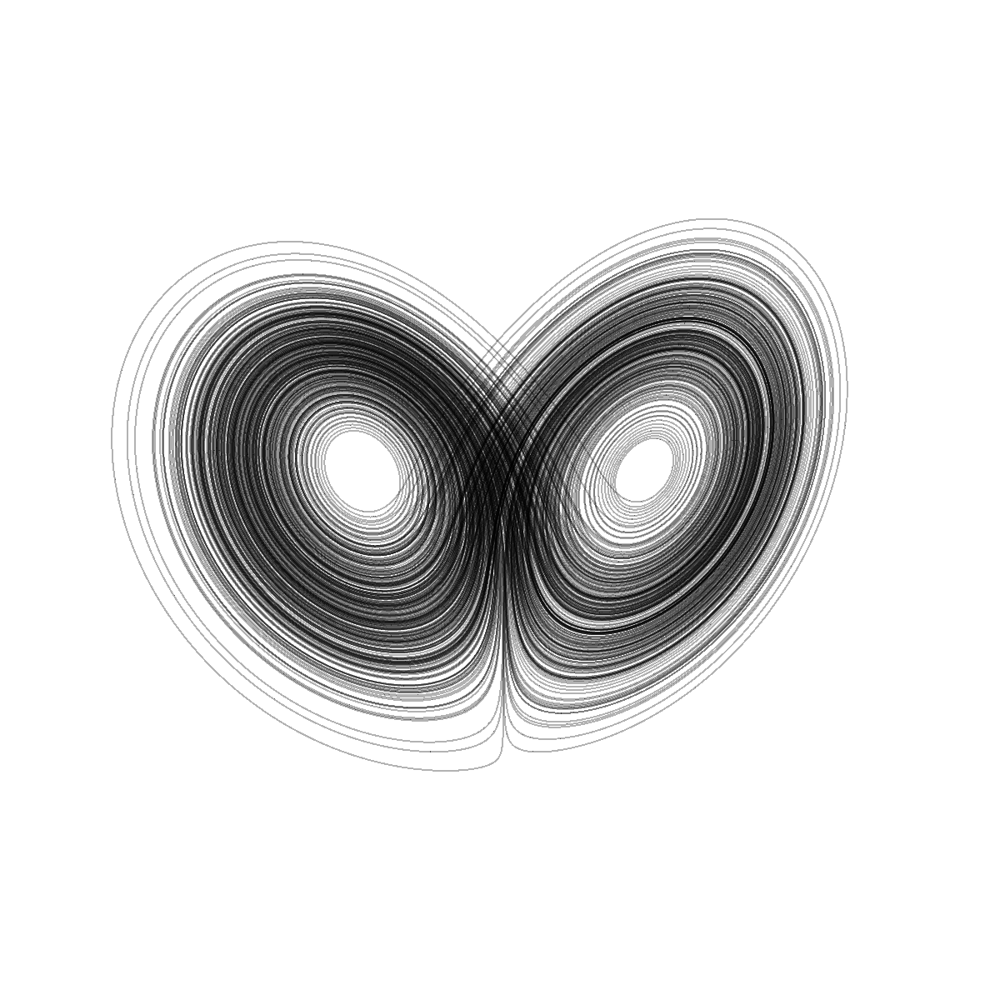

In [28]:
// Note:
//  - Remove the last line if you would like to view the 3D plot interactively in the notebook.
//  - Replace the last line with Chart.show if you would like to view the 3D plot interative in the browser.

lorenzHighIterations
|> List.filter (fun {Time = t} -> t >= 10)
|> plot
|> (fun chart -> Chart.Display3D(1.5, -1.5, 0.1, chart))

In [29]:
let xRange = [-20.0 .. 2.0 .. 20.0]
let yRange = [-20.0 .. 2.0 .. 20.0]
let zRange = [  0.0 .. 2.5 .. 50.0]

let lorenzInitialConditionCube =
    [for x in xRange do
        for y in yRange do
            for z in zRange ->
                {X = x; Y = y; Z = z}]

In [30]:
let attractorPointMarker = Marker.init(
    Size = 1,
    Color = Color.fromARGB 15 0 0 0
)

let around time value =
    let epsilon = 0.000001
    abs (value - time) <= epsilon

let solutions =
    lorenzInitialConditionCube
    |> List.map (fun point -> eulersMethod3D {lorenzSystem with InitialCondition = point} 0.01 21.0)

let solutionsAt time =
    solutions
    |> List.map (List.filter (fun {Time = t} -> around time t))
    |> List.concat
    |> List.map (fun {Coordinate = c} -> c.AsTuple)

[
    solutionsAt 0.0
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker

    solutionsAt 0.1
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker

    solutionsAt 0.2
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker

    solutionsAt 1.0
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker

    solutionsAt 5.0
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker

    solutionsAt 20.0
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker
]
|> Chart.Grid(3, 2)
|> Chart.withSize(800, 800)


// [
//     lorenzInitialConditionCube
//     |> List.map Coordinate.ToTuple
//     |> Chart.Point3D
//     |> Chart.withMarker attractorPointMarker

//     lorenzInitialConditionCube
//     |> List.map Coordinate.ToTuple
//     |> List.map (eulersMethod3D dxdt dydt dzdt x0 y0 z0 0.01 )

<!-- Plotly chart will be drawn inside this DIV -->

### The Rössler Attractor

$$
\begin{align*}
\frac{dx}{dt} &= - y - z \\
\frac{dy}{dt} &= x + a y \\
\frac{dz}{dt} &= b + z(x-c) 
\end{align*}
$$

Let $ a = 0.1$, $b = 0.1$, and $c = 14$, and choose the initial conditions of $x(0) = 10$, $y(0) = 10$, and $z(0) = 10$ with a step size of $\Delta t = 0.0001$.

In [31]:
let a = 0.1
let b = 0.1
let c = 14.0
let x0, y0, z0 = 10, 10, 10
let deltaT = 0.001

let dxdt _x  y  z: float = - y - z
let dydt  x  y _z: float = x + a * y
let dzdt  x _y  z: float = b + z * (x - c)

let rosslerSystem =
    { DxDt = fun x y z -> - y - z
      DyDt = fun x  y _z -> x + a * y
      DzDt = fun x y z -> b + z * (x - c)
      InitialCondition = {X = x0; Y = y0; Z = z0}
}

let rossler = eulersMethod3D rosslerSystem deltaT 70.0

let rosslerHighIterations = eulersMethod3D rosslerSystem deltaT 1000.0

In [32]:
let attractorPointMarker = Marker.init(
    Size = 1,
    Color = Color.fromARGB 15 0 0 0
)

let around time value =
    let epsilon = 0.000001
    abs (value - time) <= epsilon

let solutions =
    lorenzInitialConditionCube
    |> List.map (fun point -> eulersMethod3D {rosslerSystem with InitialCondition = point} 0.1 21.0)

let solutionsAt time =
    solutions
    |> List.map (List.filter (fun {Time = t} -> around time t))
    |> List.concat
    |> List.map (fun {Coordinate = c} -> c.AsTuple)

[
    solutionsAt 0.0
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker

    solutionsAt 0.1
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker

    solutionsAt 0.2
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker

    solutionsAt 1.0
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker

    solutionsAt 5.0
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker

    solutionsAt 20.0
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker
]
|> Chart.Grid(3, 3)
|> Chart.withSize(800, 800)

<!-- Plotly chart will be drawn inside this DIV -->

In [33]:
let rosslerXAxis2D = LinearAxis.init(
    Title = Title.init "t",
    Color = Color.fromKeyword Black,
    ShowLine = true,
    LineColor = Color.fromKeyword Black,
    LineWidth = 2,
    Mirror = StyleParam.Mirror.True,
    Ticks = StyleParam.TickOptions.Inside,
    TickMode = StyleParam.TickMode.Linear,
    TickWidth = 2,
    Tick0 = 0,
    DTick = 10
)

let rosslerYAxis2D title (min, max) = LinearAxis.init(
    Title = Title.init title,
    Range = StyleParam.Range.ofMinMax (min, max),
    Color = Color.fromKeyword Black,
    ZeroLine = true,
    ZeroLineColor = Color.fromKeyword Black,
    ZeroLineWidth = 1,
    ShowLine = true,
    LineColor = Color.fromKeyword Black,
    LineWidth = 2,
    Mirror = StyleParam.Mirror.True,
    Ticks = StyleParam.TickOptions.Inside,
    TickMode = StyleParam.TickMode.Linear,
    TickWidth = 2,
    DTick = 10
)

let rosslerLayout = Layout.init(
    Width = 400,
    Height = 200,
    Margin = Margin.init(20, 20, 20, 20),
    PlotBGColor = Color.fromKeyword(White),
    PaperBGColor = Color.fromKeyword(White)
)

let rosslerMarker = Marker.init(
    Color = Color.fromKeyword(Black)
)

let plotRosslerAxis yAxisName (min, max) data =
    data
    |> Chart.Line
    |> Chart.withMarker rosslerMarker
    |> Chart.withLayout rosslerLayout
    |> Chart.withXAxis rosslerXAxis2D
    |> Chart.withYAxis (rosslerYAxis2D yAxisName (min, max))

In [34]:
[
    rossler
    |> List.map (fun plot -> (plot.Time, plot.Coordinate.X))
    |> plotRosslerAxis "x(t)" (-20, 30);

    rossler
    |> List.map (fun plot -> (plot.Time, plot.Coordinate.Y))
    |> plotRosslerAxis "y(t)" (-30, 20);

    rossler
    |> List.map (fun plot -> (plot.Time, plot.Coordinate.Z))
    |> plotRosslerAxis "z(t)" (0, 40);
]
|> Chart.Grid(3, 1)
|> Chart.withLayoutStyle(ShowLegend = false, Width = 400, Height = 600)
|> Chart.Display

<path class="js-line" d="M0,54.34L1.83,71.69L1.84,71.73L8.63,120.04L8.64,120.06L10.13,122.76L10.13,122.76L10.14,122.76L11.05,122.19L11.05,122.18L11.06,122.17L12.26,118.8L12.26,118.78L13.91,109.71L13.91,109.68L17.68,75.91L17.68,75.87L22.62,36.95L22.63,36.93L24.26,33.46L24.26,33.46L24.27,33.45L25.12,34.31L25.12,34.32L26.36,39.08L26.36,39.1L28.03,51.24L28.03,51.28L31.07,81.6L31.07,81.64L32.77,100.02L32.77,100.07L36.92,131.9L36.93,131.92L38.35,134.5L38.38,134.49L38.39,134.49L39.24,133.42L39.25,133.41L40.53,128.21L40.53,128.18L42.08,116.63L42.08,116.59L44.57,89.09L44.57,89.03L46.1,69.63L46.1,69.57L47.89,47.94L47.89,47.89L51.68,21.34L51.68,21.34L51.69,21.34L52.2,21.89L52.22,21.97L52.22,21.98L52.9,27.42L52.9,27.48L55.89,73.83L55.9,73.85L58.54,88.97L58.55,88.99L60.89,100.91L60.9,100.93L62.88,107.45L62.89,107.46L64.46,109.25L64.46,109.25L64.47,109.25L65.56,108.5L65.56,108.5L65.57,108.49L67.15,104.51L67.16,104.49L70.04,89.98L70.04,89.95L73.38,68.12L73.38,68.09L77.12,50.85L77.13,50.84L78.69,49.09L78.69,49.09L78.7,49.09L79.76,50.14L79.76,50.15L81.09,53.97L81.09,53.99L83.08,64.32L83.08,64.35L84.91,77.3L84.91,77.34L87,93.47L87,93.51L90.02,112.8L90.03,112.82L92,118.87L92,118.87L92.01,118.88L93.17,119.2L93.2,119.17L93.21,119.16L94.33,116.99L94.33,116.97L95.98,109.68L95.98,109.65L97.85,96.49L97.85,96.45L104.57,42.71L104.58,42.69L106.28,37.64L106.29,37.64L107.18,37.5L107.33,37.65L107.33,37.66L108.43,40.35L108.43,40.37L110.15,49.7L110.15,49.73L114.35,89.01L114.35,89.06L119.13,128.36L119.14,128.38L120.6,132.14L120.6,132.14L120.61,132.14L121.5,131.83L121.5,131.82L121.51,131.81L122.62,128.6L122.62,128.58L124.13,119.47L124.13,119.43L125.45,107.66L125.45,107.61L128.15,76.56L128.15,76.5L129.65,58.49L129.65,58.44L131.73,37.07L131.74,37.03L133.13,27.38L133.14,27.36L134.57,23.4L134.63,23.43L134.64,23.43L135.25,25.09L135.25,25.11L136.03,32.79L136.03,32.86L136.9,49.05L136.9,49.14L139.07,73.89L139.08,73.92L143.7,104.92L143.71,104.94L146.46,115.01L146.47,115.02L147.77,115.71L147.77,115.7L148.81,114.18L148.82,114.17L150.49,107.99L150.49,107.96L153.01,91.6L153.01,91.56L158.86,48.23L158.87,48.21L160.89,41.86L160.9,41.86L161.92,41.62L162,41.7L162.01,41.7L163.19,44.27L163.19,44.28L164.63,50.95L164.63,50.98L166.65,65.79L166.65,65.83L174.19,125.68L174.2,125.69L175.6,128.06L175.6,128.06L175.61,128.06L176.51,127.19L176.51,127.18L177.72,123.1L177.72,123.08L179.8,108.91L179.8,108.87L182.02,86.59L182.02,86.54L184.83,55.61L184.84,55.57L188.4,29.61L188.41,29.59L189.59,27.67L189.68,27.72L189.69,27.72L190.46,29.54L190.47,29.56L191.75,39.7L191.75,39.76L194.59,71.18L194.6,71.23L201.5,125.41L201.51,125.42L203.04,127.83L203.04,127.83L203.05,127.83L203.99,126.62L204,126.61L205.28,121.72L205.28,121.7L207.15,108.58L207.15,108.54L209.38,86.17L209.38,86.12L210.95,68.68L210.95,68.63L213,47.63L213,47.58L216.03,28.96L216.04,28.95L216.95,27.92L217.17,28.1L217.18,28.11L217.99,30.59L217.99,30.61L219.23,41.21L219.23,41.26L220.85,60.24L220.85,60.29L228.45,124.36L228.46,124.38L230,128.26L230,128.26L230.01,128.27L230.94,127.98L230.94,127.97L230.95,127.97L232.14,124.62L232.14,124.6L233.61,116.21L233.61,116.18L237.07,82.7L237.07,82.65L239.84,52.28L239.85,52.23L241.4,38.59L241.41,38.55L243.45,28.22L243.46,28.2L244.31,27.33L244.54,27.55L244.55,27.56L245.35,30.26L245.35,30.29L246.36,39.12L246.36,39.18L248.97,69.02L248.98,69.06L250.63,84.44L250.64,84.49L255.82,123.5L255.83,123.51L257.45,126.94L257.45,126.94L257.46,126.94L258.33,126.37L258.33,126.36L258.34,126.35L259.53,122.77L259.53,122.75L261.13,113.28L261.13,113.25L265.38,71.12L265.38,71.07L267.47,49.76L267.47,49.72L270.46,30.49L270.47,30.48L271.61,28.84L271.76,28.94L271.77,28.94L272.62,31.1L272.62,31.12L273.69,38.48L273.69,38.53L277.02,73.2L277.02,73.25L283.42,126.9L283.43,126.92L285.05,130.37L285.06,130.37L285.95,129.57L285.95,129.56L287.14,125.52L287.14,125.49L289.11,111.87L289.11,111.83L291.56,86.25L291.56,86.2L292.89,70.59L292.89,70.54L294.85,48.85L294.85,48.8L298.02,26.65L298.03,26.64L298.93,25.27L299.19,25.51L299.2,25.52L299.91,28.27L299.9

In [35]:
rossler
|> List.map (fun plot -> plot.Coordinate.AsTuple)
|> Chart.Line3D

<!-- Plotly chart will be drawn inside this DIV -->


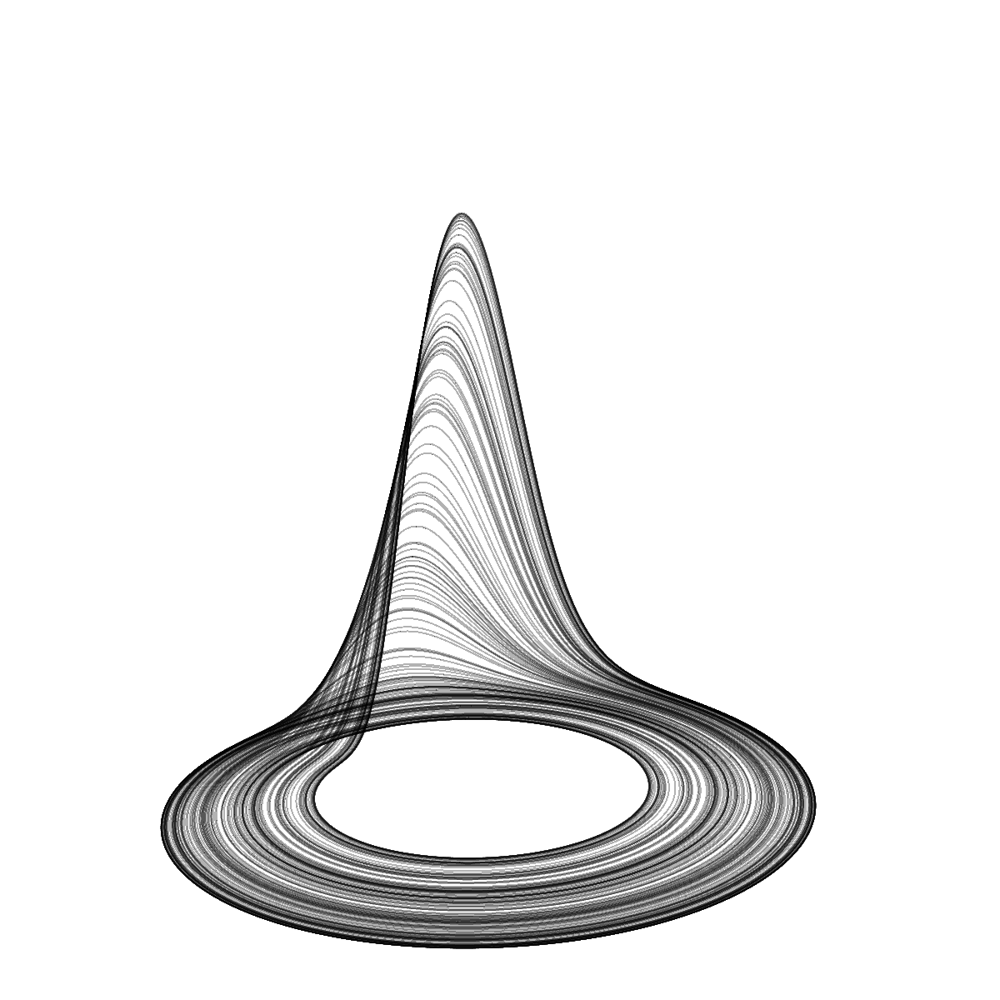

In [36]:
// Note:
//  - Remove the last line if you would like to view the 3D plot interactively in the notebook.
//  - Replace the last line with Chart.show if you would like to view the 3D plot interative in the browser.

rosslerHighIterations
|> plot
|> (fun chart -> Chart.Display3D(-1.7, -0.5, 0.3, chart))